#How to use YoloV5 on Custom Dataset

* In this notebook, you will be shown how to train a YoloV5 Object detection model on a custom dataset.
* For this notebook, we are using the dataset given below from roboflow:
https://universe.roboflow.com/my-game-pics/my-game-pics
* This dataset is an animal object detection dataset which localizes the animals in the given image
* For now, there are only 5 animal classes present in this dataset:

    1. **Coyote**

    2. **Deer**

    3. **Hog**

    4. **Rabbit**

    5. **Raccoon**


* Since I have already downloaded the dataset from Roboflow and uploaded it to drive, I will use Drive Download(**!gdown**) Command to download it on current runtime

In [1]:
# Downloading the dataset
!gdown --id 16u5_p5pb6WfH0xVqzGmpipD0tX1z0Bbv

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=16u5_p5pb6WfH0xVqzGmpipD0tX1z0Bbv
To: /content/Animal_Detection.zip
100% 638M/638M [00:02<00:00, 267MB/s]


Since the dataset is compressed in a zip format, we need to unzip it in order to work on it

In [2]:
!unzip Animal_Detection.zip

Streaming output truncated to the last 5000 lines.
 extracting: train/labels/5a9c024d-8f35-4c75-9146-2f9815fca7a6_jpg.rf.32f155d15475d381507a24081404e2ab.txt  
 extracting: train/labels/5a9c024d-8f35-4c75-9146-2f9815fca7a6_jpg.rf.71c84e581cb5e26fa6609427b8e29b1d.txt  
 extracting: train/labels/5a9c024d-8f35-4c75-9146-2f9815fca7a6_jpg.rf.f53f8750aa38710c476e1ec8c067b6e8.txt  
 extracting: train/labels/5ac94a2a-e9df-4a05-812c-bcec94036887_jpg.rf.55778d146f08cabcd13386f155fa7658.txt  
 extracting: train/labels/5ac94a2a-e9df-4a05-812c-bcec94036887_jpg.rf.8d520859e594b8a79e5ef0e2d1d23a8f.txt  
 extracting: train/labels/5ac94a2a-e9df-4a05-812c-bcec94036887_jpg.rf.f8e85563e96025bbe40a42cd9034af6b.txt  
 extracting: train/labels/5ad4cf50-5839-4443-acf6-35c5a6d68225_jpg.rf.13f8d4caa4155e3b212cb340c9d76211.txt  
 extracting: train/labels/5ad4cf50-5839-4443-acf6-35c5a6d68225_jpg.rf.b64d4fc1bf3ced7c679448ff8d942b33.txt  
 extracting: train/labels/5ad4cf50-5839-4443-acf6-35c5a6d68225_jpg.rf.e31ec7c

After unzipping, let us try to visualize the sample images with their respective bounding boxes

In [9]:
# importing necessary libraries
import os
import yaml
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np

* The dataset in YOLO format always comes with a data.yaml file.

* The data.yaml file that stores necessary information about our dataset.

* It mainly contains:

  1. Specifies where our training, validation and test data(in some cases) is
  2. The number of classes that we want to detect
  3. The names corresponding to those classes

* In our case it looks something as given below


  ```
      # data.yaml
      train: ../train/images
      val: ../valid/images
      test: ../test/images

      nc: 5
      names: ['Coyote', 'Deer', 'Hog', 'Rabbit', 'Raccoon']
  ```


* Let us load that file as well as it will be important for visualiztion

In [4]:
# Load the data.yaml file
data_yaml_path = "/content/data.yaml"
with open(data_yaml_path, "r") as file:
    data = yaml.safe_load(file)

# Get the class labels
class_labels = data["names"]

Specify the image directories along with their labels

In [6]:
train_images="/content/train/images"
train_labels="/content/train/labels"
valid_images="/content/valid/images"
valid_labels="/content/valid/labels"
test_images="/content/test/images"
test_labels="/content/test/labels"

Create a function to visualize sample images

In [7]:
def visualize_samples(images_path, annotations_path, class_labels, num_samples=10, figure_size=(24, 12), colors=None):
    if colors is None:
        colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0), (0, 255, 255)]

    sample_indices = np.random.choice(len(os.listdir(images_path)), num_samples, replace=False)

    plt.figure(figsize=figure_size)

    for i, idx in enumerate(sample_indices):
        image_file = os.listdir(images_path)[idx]
        image_path = os.path.join(images_path, image_file)
        label_file = image_file.replace(".jpg", ".txt").replace(".png", ".txt")
        label_path = os.path.join(annotations_path, label_file)

        image = cv2.imread(image_path)
        height, width, _ = image.shape

        with open(label_path, "r") as file:
            annotations = file.readlines()

        plt.subplot(2, num_samples // 2, i + 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.axis("off")

        for j, annotation in enumerate(annotations):
            class_id, x, y, w, h = map(float, annotation.split())
            x *= width
            y *= height
            w *= width
            h *= height

            color = colors[j % len(colors)]

            bbox = cv2.rectangle(image, (int(x - w / 2), int(y - h / 2)), (int(x + w / 2), int(y + h / 2)), color, 2)
            bbox = cv2.putText(bbox, class_labels[int(class_id)], (int(x - w / 2), int(y - h / 2 - 10)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

        plt.imshow(cv2.cvtColor(bbox, cv2.COLOR_BGR2RGB))

    plt.suptitle("Sample Images with Bounding Boxes", fontsize=16)
    plt.tight_layout()
    plt.show()

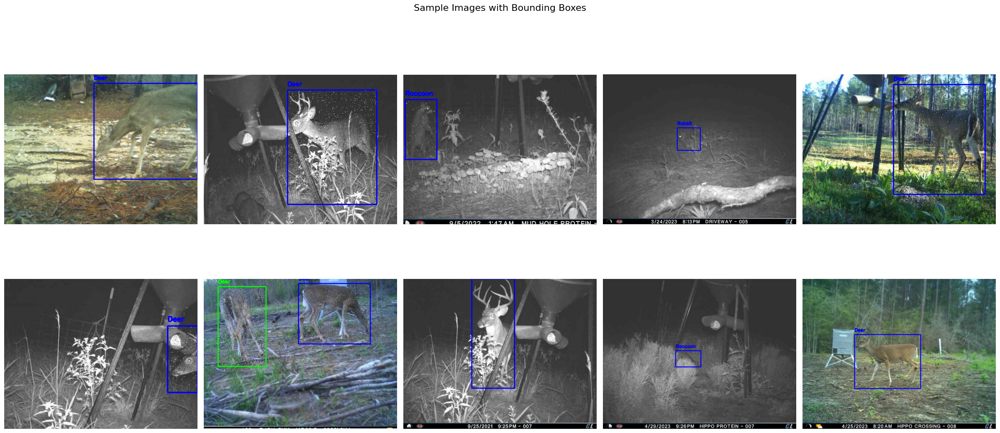

In [10]:
# Visualize samples from the training directory
visualize_samples(train_images, train_labels, class_labels)

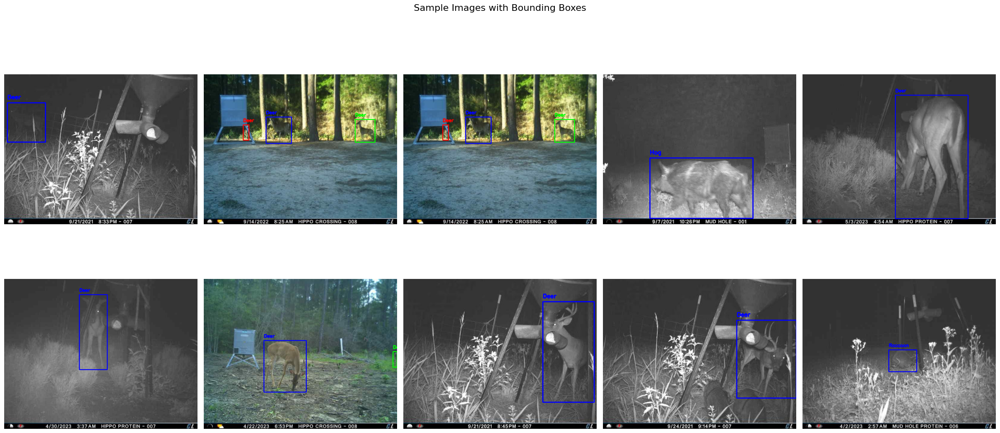

In [11]:
# Visualize samples from the validation directory
visualize_samples(valid_images, valid_labels, class_labels)

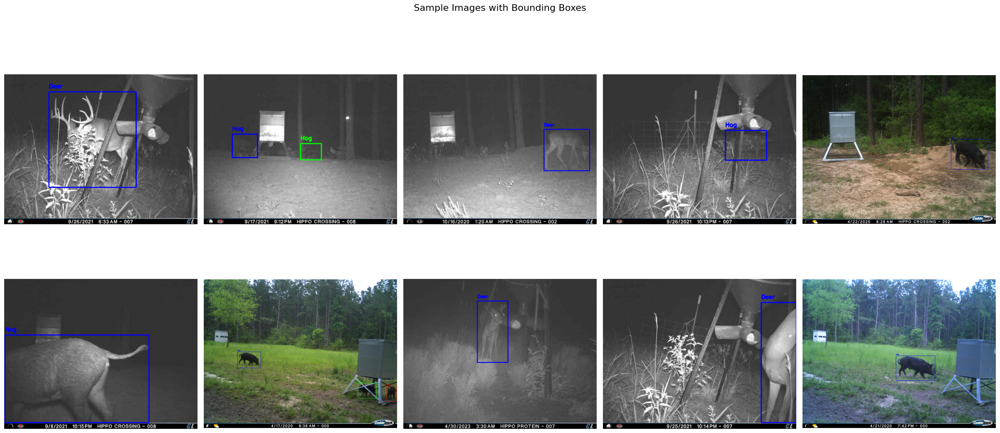

In [12]:
# Visualize samples from the test directory
visualize_samples(test_images, test_labels, class_labels)

After getting a close look at our data, download the yolov5 model from the git repo

In [3]:
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 16003, done.
remote: Counting objects: 100% (36/36), done.
remote: Compressing objects: 100% (23/23), done.
remote: Total 16003 (delta 21), reused 20 (delta 13), pack-reused 15967
Receiving objects: 100% (16003/16003), 14.66 MiB | 22.67 MiB/s, done.
Resolving deltas: 100% (10983/10983), done.


Install the required dependencies

In [4]:
!pip install -U -r yolov5/requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.0/190.0 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 93.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.2/18.2 MB 83.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 MB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 96.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 670.2/670.2 MB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 105.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 617.4/617.4 kB 55.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 110.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 36.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 807.9/807.9 kB 68.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━

Restart the runtime for the libraries to load. Don't worry, this won't delete our files and models that we have downloaded earlier

In [2]:
%cd /content/yolov5

/content/yolov5


In [3]:
!python train.py \
    --img-size 640 \
    --batch-size 32 \
    --epochs 10 \
    --data /content/data.yaml \
    --cfg models/yolov5s.yaml \
    --weights yolov5s.pt \
    --optimizer Adam\
    --hyp /content/yolov5/data/hyps/hyp.scratch-low.yaml

train: weights=yolov5s.pt, cfg=models/yolov5s.yaml, data=/content/data.yaml, hyp=/content/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=10, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=Adam, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-226-gdd9e338 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.001, lrf=0.01, momentum=0.9, weight_decay=0.0001, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamm

In [4]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [13]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source /content/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-226-gdd9e338 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
image 1/357 /content/test/images/0250cc8b-0ed1-4b3a-83d0-bf85cebd51a0_jpg.rf.252f340ea4559b47cdbdb93d6b663400.jpg: 512x640 1 Deer, 52.3ms
image 2/357 /content/test/images/04d7b6a0-9b9c-42dc-b2eb-35dd53932a92_jpg.rf.4c37794713a22b2374f8ec192ef51c61.jpg: 512x640 3 Deers, 9.1ms
image 3/357 /content/test/images/04ed99b3-b4ab-4ac9

In [14]:
import os
predicted_files = []
for (dirpath, dirnames, filenames) in os.walk("runs/detect/exp2"):
    predicted_files.extend(filenames)

In [15]:
from IPython.display import Image
import random

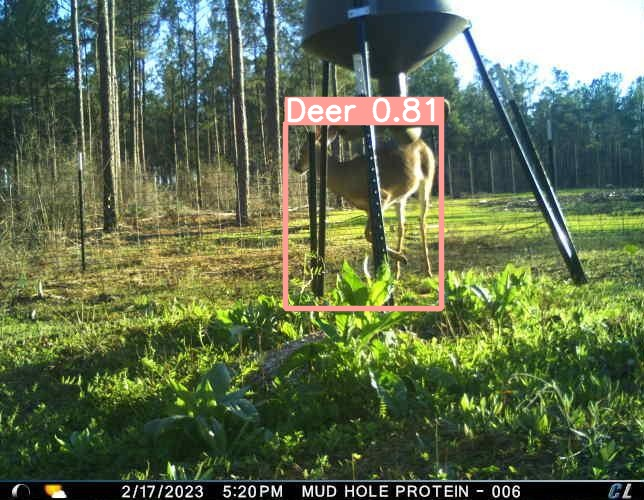

In [21]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

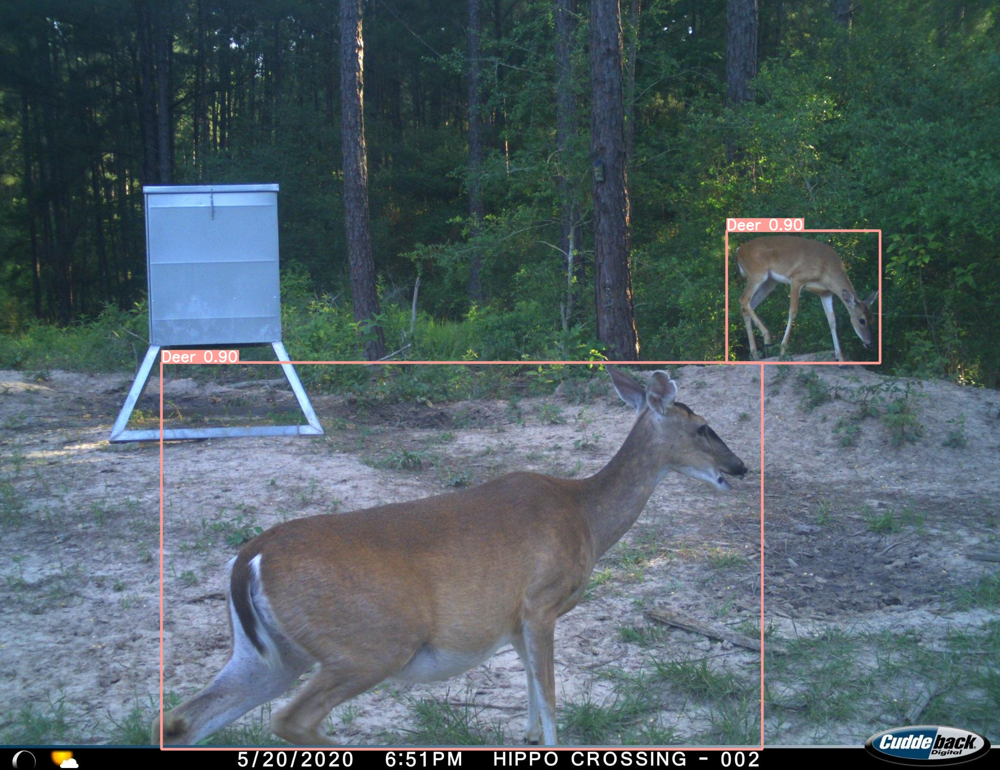

In [22]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

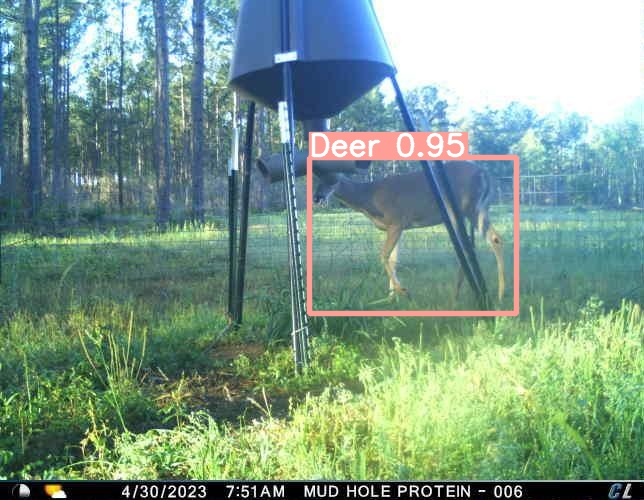

In [23]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

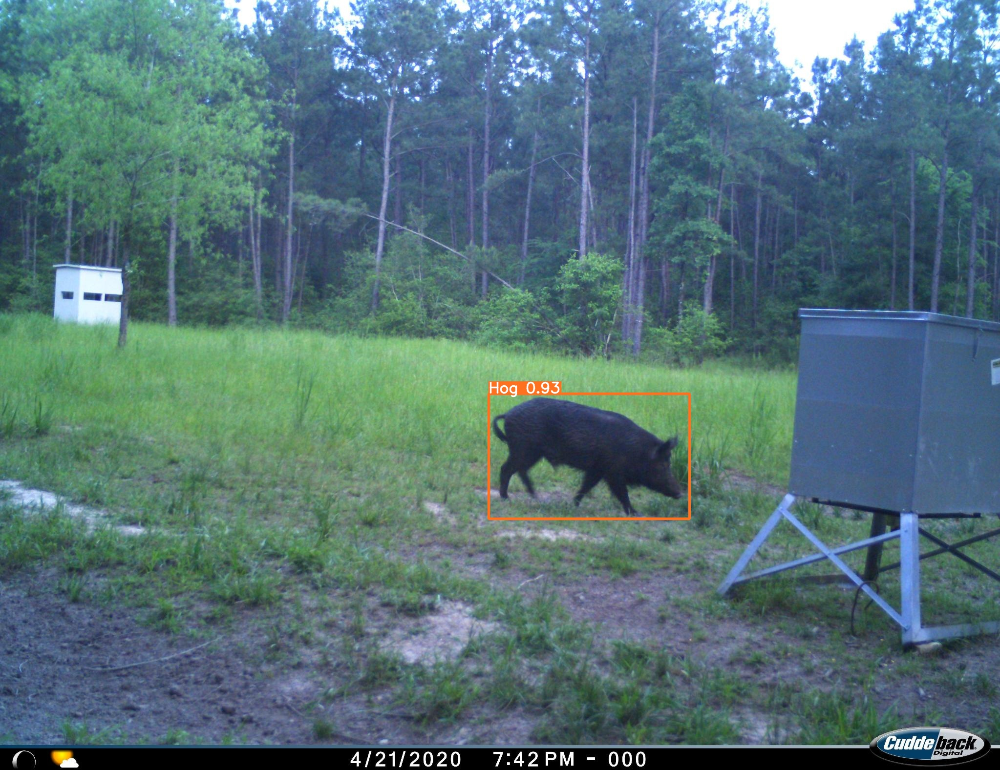

In [24]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

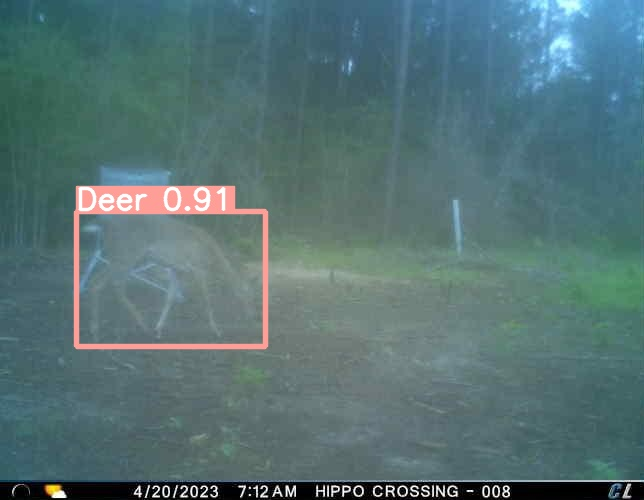

In [25]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

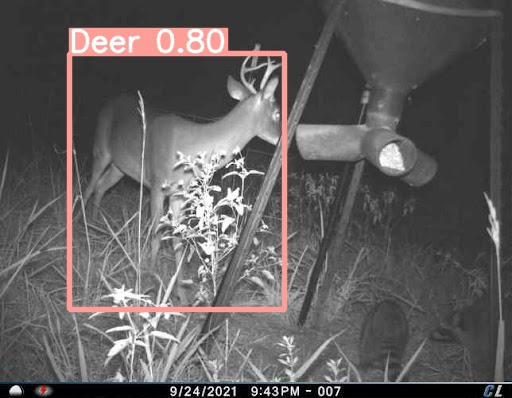

In [26]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

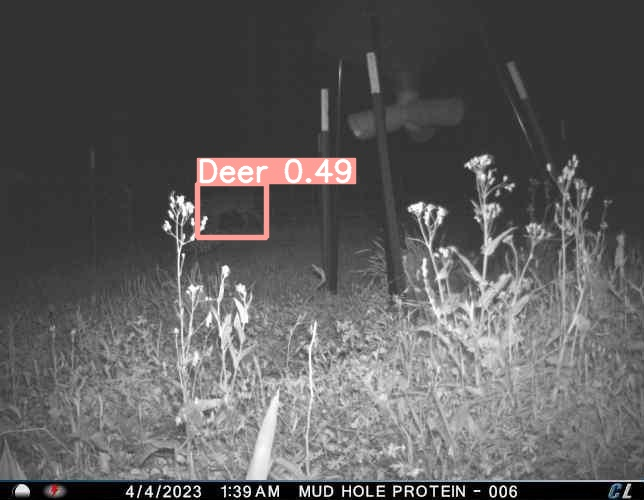

In [27]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

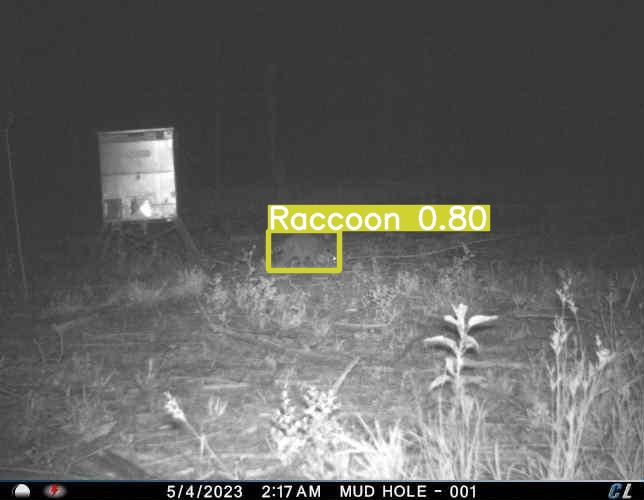

In [28]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

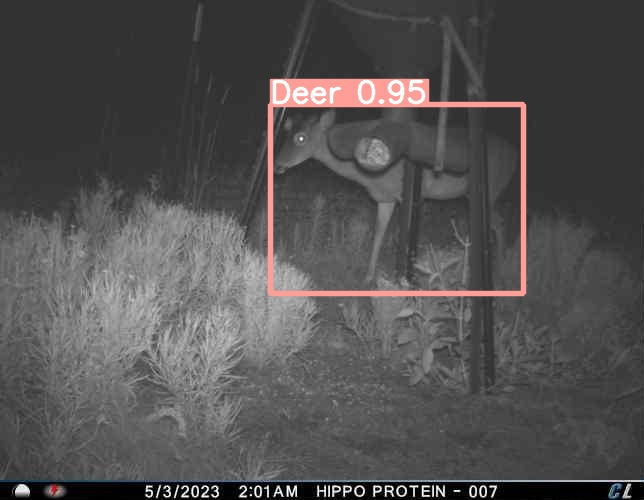

In [29]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

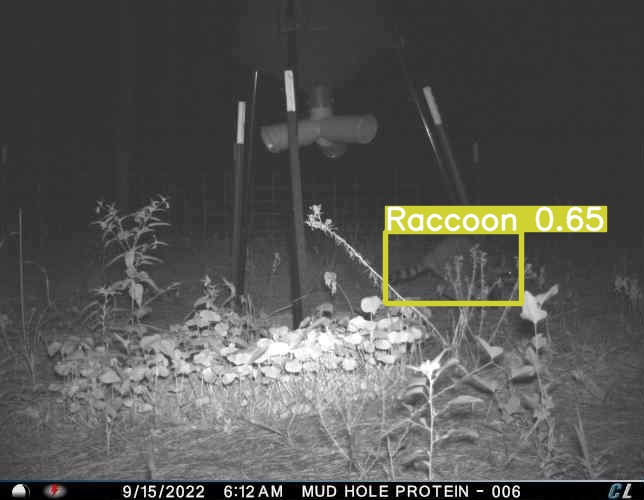

In [30]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

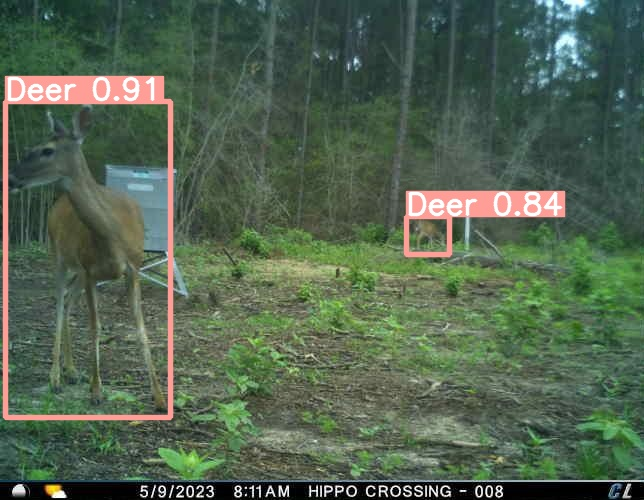

In [32]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

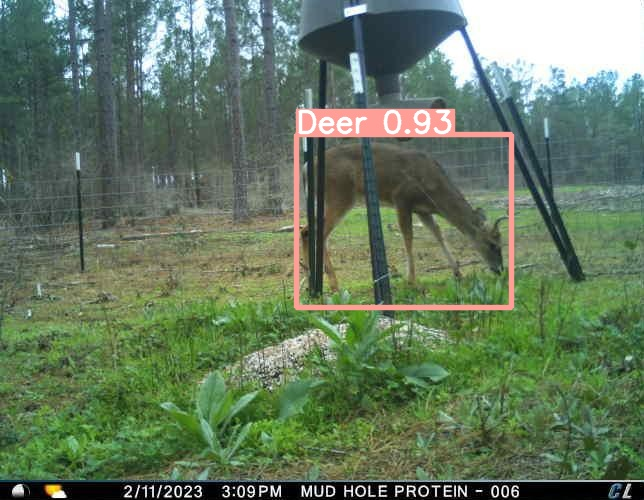

In [33]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

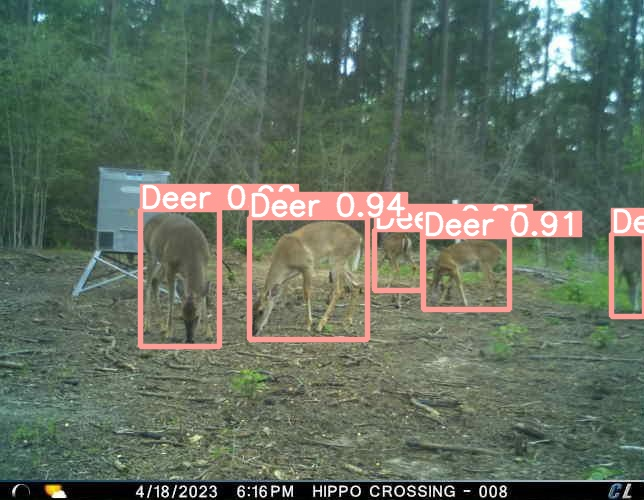

In [34]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

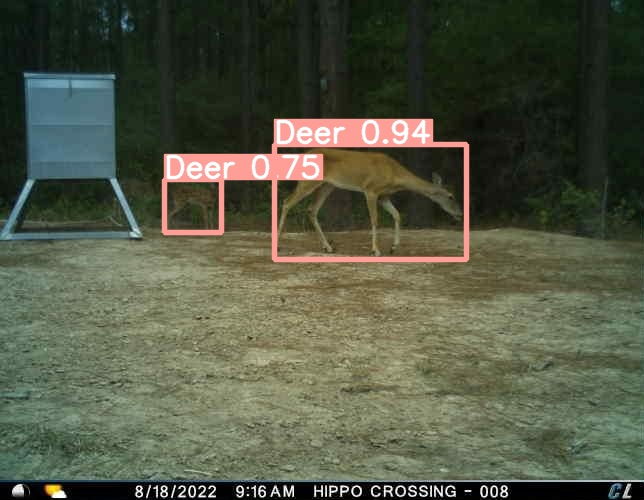

In [35]:
Image(filename=f'runs/detect/exp/{random.choice(predicted_files)}')

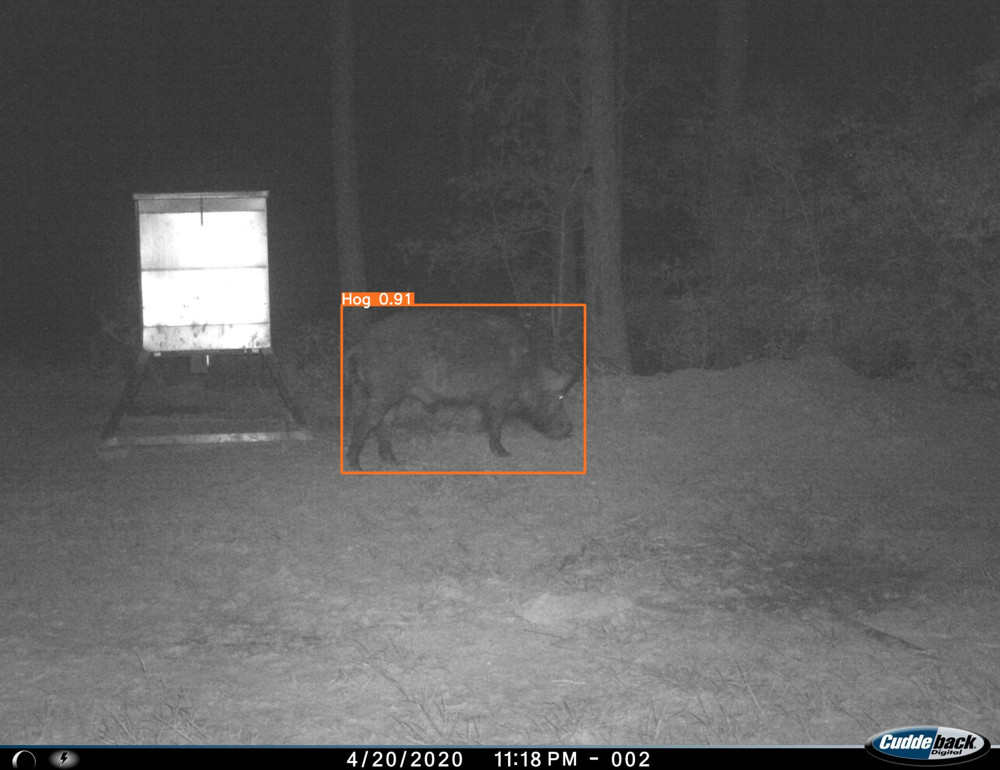

In [41]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

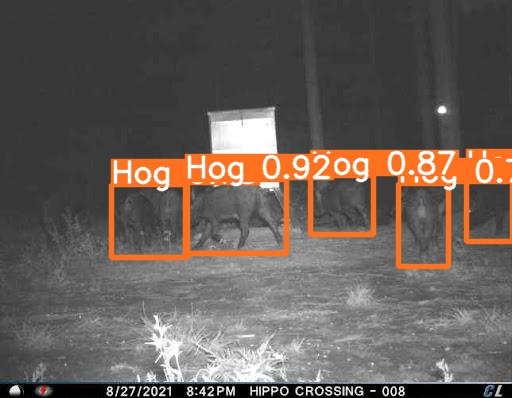

In [52]:
Image(filename=f'runs/detect/exp2/{random.choice(predicted_files)}')

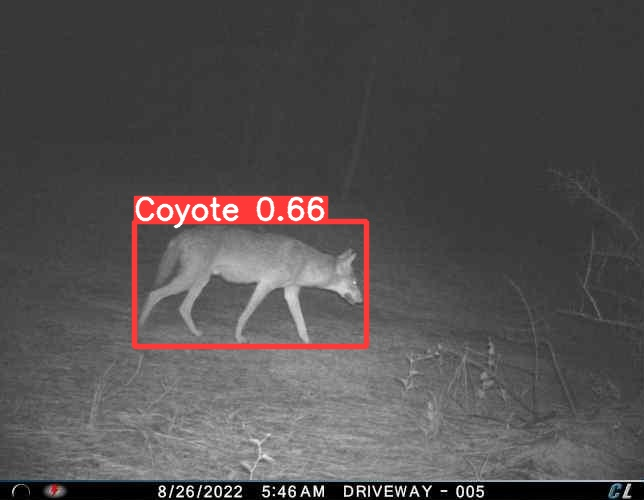

In [53]:
Image(filename=f'runs/detect/exp2/Deer-DRIVEWAY-20220826_054648_JPG.rf.1b9ce9719d396b741437b167da80befa.jpg')

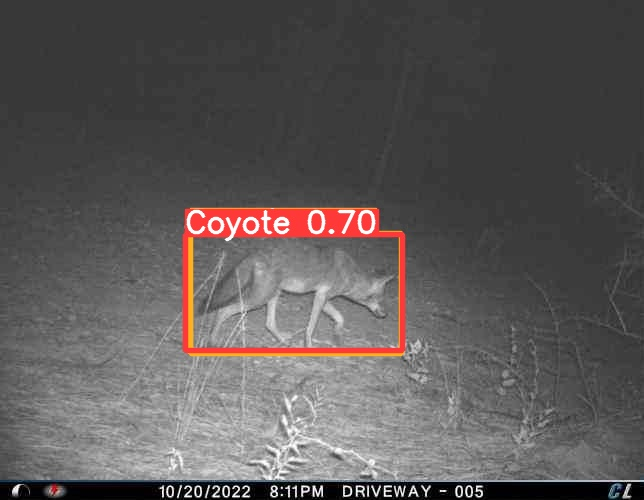

In [54]:
Image(filename=f'runs/detect/exp2/T_00002_jpg.rf.41f7f66a33eed1eee27dbe0176d9a71c.jpg')

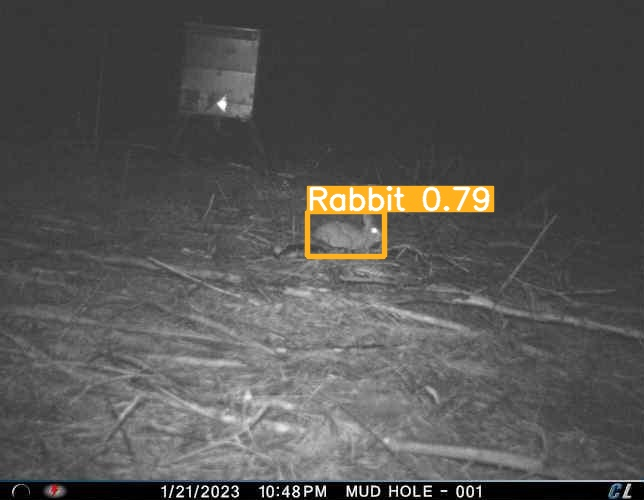

In [55]:
Image(filename=f'runs/detect/exp2/be4ccb1c-8c89-4d42-92ed-9462157c32b5_jpg.rf.61a15672bce1dc07b81527aa27f772d0.jpg')

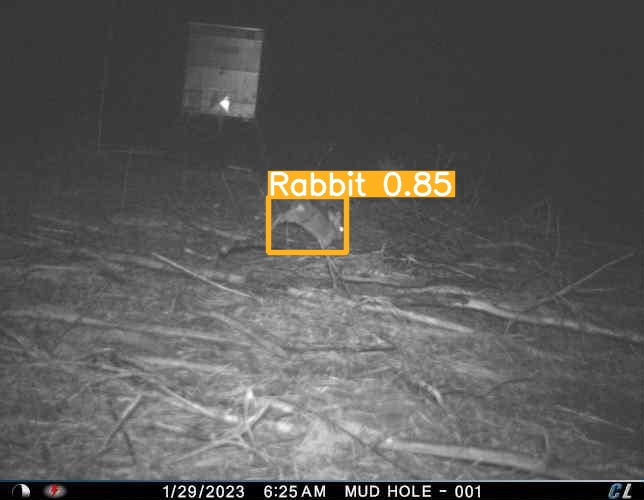

In [56]:
Image(filename=f'runs/detect/exp2/d4d52f8e-4f24-4780-9f0b-dcb3924f2037_jpg.rf.9a65772312431f2ada0301cb06529e27.jpg')